In [115]:
!pip install magpylib

In [117]:
import magpylib as magpy
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick

chip_size = 2e-5        #20micrometer
chip_dist = 7e-2        #7cm away
magnet_size = (0.05, 0.1, 0.1)
resolution = 20
z_resolution = 21
angle_resolution = 41
fluc_resolution = 61
fluc_min = 0
fluc_max = 2e-3/3

# Magnet simulation

In [91]:
cube = magpy.magnet.Cuboid(polarization=(500, 0, 0), dimension=magnet_size)
steps = np.array([(0, yi, 0) for yi in np.linspace(-0.1, 0.1, 51)])
cube.position=steps

pixel_grid = np.mgrid[-0.22:0.2:12j, -0.2:0.2:12j, chip_dist+0.05:chip_dist+0.05:1j].T[0]
sensor = magpy.Sensor(pixel=pixel_grid)

magpy.show(
    cube,
    sensor,
    animation=True,
    style_pixel_field_symbol="arrow3d",
    style_pixel_field_source="B",
    backend="plotly",
)

# Deviation

The deviation is defined as

$deviation=max_{ij}||B_i-B_j||_2/⟨B⟩$

In [92]:
cube = magpy.magnet.Cuboid(polarization=(500, 0, 0), dimension=magnet_size)
steps = np.array([(0, 0, zi) for zi in np.linspace(-chip_dist, chip_dist, z_resolution)])
cube.position=steps

x = np.linspace(-chip_size / 2, chip_size / 2, resolution)
y = np.linspace(-chip_size / 2, chip_size / 2, resolution)
chip_points = np.array([
    [(xi, yi, 0) for yi in y]
    for xi in x
])

sensor = magpy.Sensor(pixel=chip_points)
sensor.position = (0, 0, chip_dist+0.05)

B = magpy.getB(cube, sensor)
print(B.shape)

(21, 20, 20, 3)


In [93]:

B_flat = B.reshape((z_resolution, resolution**2, 3))
diff = np.array([[[vec1 - vec2 for vec1 in B_flat_zi] for vec2 in B_flat_zi] for B_flat_zi in B_flat])
amp_diff = np.linalg.norm(diff, axis=3)
max_diff = np.max(amp_diff,axis=(1,2))
mean_B = np.mean(np.linalg.norm(B,axis=3),axis=(1,2))
deviation = max_diff / mean_B
print(f"Max Difference: {max_diff}")
print(f"Mean B: {mean_B}")
print(f"Deviation: {deviation}")

Max Difference: [0.00102772 0.00120352 0.00141872 0.00168441 0.00201547 0.0024321
 0.00296214 0.00364441 0.00453384 0.00570935 0.00728601 0.009434
 0.01240819 0.01659295 0.02256542 0.03116486 0.04349168 0.06054922
 0.08179672 0.10205471 0.11061327]
Mean B: [  3.11711098   3.50656234   3.9641612    4.50554441   5.15085569
   5.92632665   6.86651615   8.01752562   9.44168159  11.22445364
  13.48481953  16.39099319  20.18451446  25.2172149   32.00710636
  41.31834263  54.25728163  72.31943205  97.14877645 129.48967642
 332.79174821]
Deviation: [0.0003297  0.00034322 0.00035789 0.00037385 0.00039129 0.00041039
 0.00043139 0.00045456 0.00048019 0.00050865 0.00054031 0.00057556
 0.00061474 0.000658   0.00070501 0.00075426 0.00080158 0.00083725
 0.00084197 0.00078813 0.00033238]


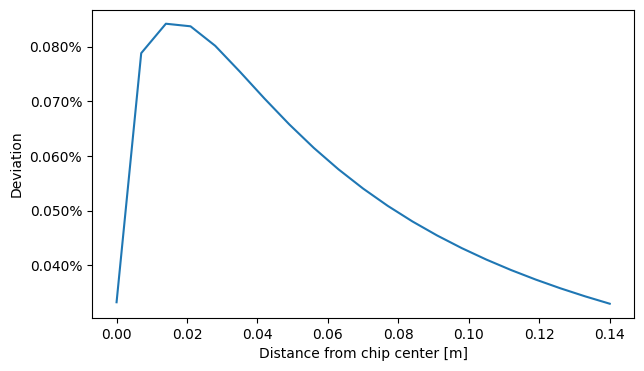

In [94]:
fig = plt.figure(1, (7,4))
ax = fig.add_subplot(1,1,1)
ax.plot(np.linspace(0, 2*chip_dist, z_resolution), deviation[::-1])
ax.set_xlabel("Distance from chip center [m]")
ax.set_ylabel("Deviation")
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.show()

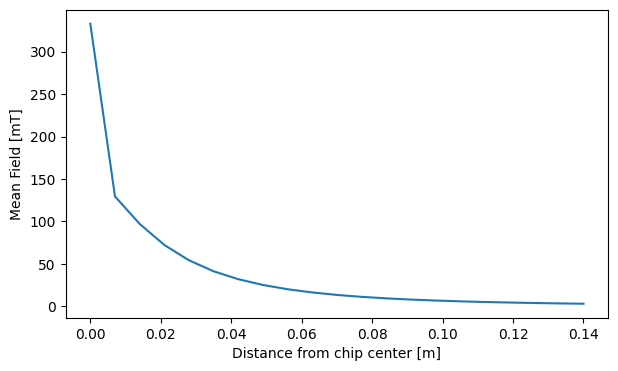

In [95]:
fig = plt.figure(1, (7,4))
ax = fig.add_subplot(1,1,1)
ax.plot(np.linspace(0, 2*chip_dist, z_resolution), mean_B[::-1])
ax.set_xlabel("Distance from chip center [m]")
ax.set_ylabel("Mean Field [mT]")
plt.show()

In [96]:
magpy.show(cube, sensor, backend="plotly", animation=True)

## Deviation with rotating chip
### x axis

In [97]:
# 7cm from the magnet with different angles
cube = magpy.magnet.Cuboid(polarization=(500, 0, 0), dimension=magnet_size)
x = np.linspace(-chip_size / 2, chip_size / 2, resolution)
y = np.linspace(-chip_size / 2, chip_size / 2, resolution)
chip_points = np.array([
    [(xi, yi, 0) for yi in y]
    for xi in x
])

sensor = magpy.Sensor(pixel=chip_points)
sensor.position = (0, 0, chip_dist+0.05)
sensor.rotate_from_rotvec([(theta, 0, 0) for theta in np.linspace(0, 360, angle_resolution)])

B = magpy.getB(cube, sensor)
print(B.shape)

(42, 20, 20, 3)


In [98]:
B_flat = B[1::].reshape((angle_resolution, resolution**2, 3))
diff = np.array([[[vec1 - vec2 for vec1 in B_flat_zi] for vec2 in B_flat_zi] for B_flat_zi in B_flat])
amp_diff = np.linalg.norm(diff, axis=3)
max_diff = np.max(amp_diff,axis=(1,2))
mean_B = np.mean(np.linalg.norm(B[1::],axis=3),axis=(1,2))
deviation = max_diff / mean_B
print(f"Max Difference: {max_diff}")
print(f"Mean B: {mean_B}")
print(f"Deviation: {deviation}")

Max Difference: [0.00728601 0.00737462 0.00762595 0.00800171 0.00845143 0.0089235
 0.00937182 0.00975861 0.01005498 0.01024074 0.01030397 0.01024074
 0.01005498 0.00975861 0.00937182 0.0089235  0.00845143 0.00800171
 0.00762595 0.00737462 0.00728601 0.00737462 0.00762595 0.00800171
 0.00845143 0.0089235  0.00937182 0.00975861 0.01005498 0.01024074
 0.01030397 0.01024074 0.01005498 0.00975861 0.00937182 0.0089235
 0.00845143 0.00800171 0.00762595 0.00737462 0.00728601]
Mean B: [13.48481953 13.48481954 13.48481956 13.48481959 13.48481963 13.48481968
 13.48481972 13.48481976 13.48481979 13.48481981 13.48481982 13.48481981
 13.48481979 13.48481976 13.48481972 13.48481968 13.48481963 13.48481959
 13.48481956 13.48481954 13.48481953 13.48481954 13.48481956 13.48481959
 13.48481963 13.48481968 13.48481972 13.48481976 13.48481979 13.48481981
 13.48481982 13.48481981 13.48481979 13.48481976 13.48481972 13.48481968
 13.48481963 13.48481959 13.48481956 13.48481954 13.48481953]
Deviation: [0.00054

<>:4: SyntaxWarning:

invalid escape sequence '\h'

<>:4: SyntaxWarning:

invalid escape sequence '\h'

/tmp/ipython-input-3560140944.py:4: SyntaxWarning:

invalid escape sequence '\h'



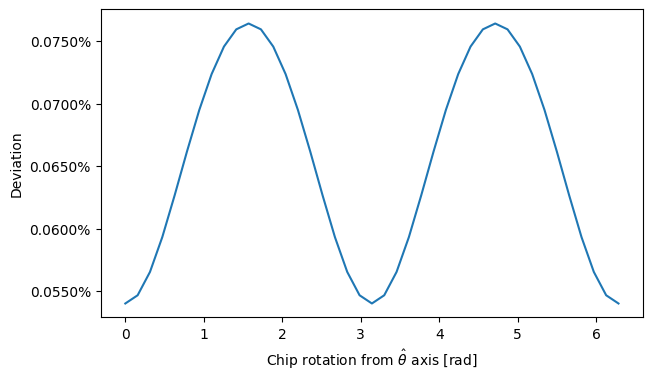

In [99]:
fig = plt.figure(1, (7,4))
ax = fig.add_subplot(1,1,1)
ax.plot(np.linspace(0, np.pi*2, angle_resolution), deviation)
ax.set_xlabel("Chip rotation from $\hat{\\theta}$ axis [rad]")
ax.set_ylabel("Deviation")
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.show()

### y axis

In [100]:
# 7cm from the magnet with different angles
cube = magpy.magnet.Cuboid(polarization=(500, 0, 0), dimension=magnet_size)

x = np.linspace(-chip_size / 2, chip_size / 2, resolution)
y = np.linspace(-chip_size / 2, chip_size / 2, resolution)
chip_points = np.array([
    [(xi, yi, 0) for yi in y]
    for xi in x
])

sensor = magpy.Sensor(pixel=chip_points)
sensor.position = (0, 0, chip_dist+0.05)
sensor.rotate_from_rotvec([(0, theta, 0) for theta in np.linspace(0, 360, angle_resolution)])

B = magpy.getB(cube, sensor)
print(B.shape)

(42, 20, 20, 3)


In [101]:
B_flat = B[1::].reshape((angle_resolution, resolution**2, 3))
diff = np.array([[[vec1 - vec2 for vec1 in B_flat_zi] for vec2 in B_flat_zi] for B_flat_zi in B_flat])
amp_diff = np.linalg.norm(diff, axis=3)
max_diff = np.max(amp_diff,axis=(1,2))
mean_B = np.mean(np.linalg.norm(B[1::],axis=3),axis=(1,2))
deviation = max_diff / mean_B
print(f"Max Difference: {max_diff}")
print(f"Mean B: {mean_B}")
print(f"Deviation: {deviation}")

Max Difference: [0.00728601 0.00728603 0.00728605 0.00728607 0.00728608 0.0072861
 0.00728611 0.00728612 0.00728613 0.00728613 0.00728614 0.00728613
 0.00728613 0.00728612 0.00728611 0.0072861  0.00728608 0.00728607
 0.00728605 0.00728603 0.00728601 0.00728603 0.00728605 0.00728607
 0.00728608 0.0072861  0.00728611 0.00728612 0.00728613 0.00728613
 0.00728614 0.00728613 0.00728613 0.00728612 0.00728611 0.0072861
 0.00728608 0.00728607 0.00728605 0.00728603 0.00728601]
Mean B: [13.48481953 13.48481954 13.48481956 13.48481959 13.48481962 13.48481966
 13.4848197  13.48481973 13.48481976 13.48481978 13.48481979 13.48481978
 13.48481976 13.48481973 13.4848197  13.48481966 13.48481962 13.48481959
 13.48481956 13.48481954 13.48481953 13.48481954 13.48481956 13.48481959
 13.48481962 13.48481966 13.4848197  13.48481973 13.48481976 13.48481978
 13.48481979 13.48481978 13.48481976 13.48481973 13.4848197  13.48481966
 13.48481962 13.48481959 13.48481956 13.48481954 13.48481953]
Deviation: [0.00054

<>:4: SyntaxWarning:

invalid escape sequence '\h'

<>:4: SyntaxWarning:

invalid escape sequence '\h'

/tmp/ipython-input-2216347213.py:4: SyntaxWarning:

invalid escape sequence '\h'



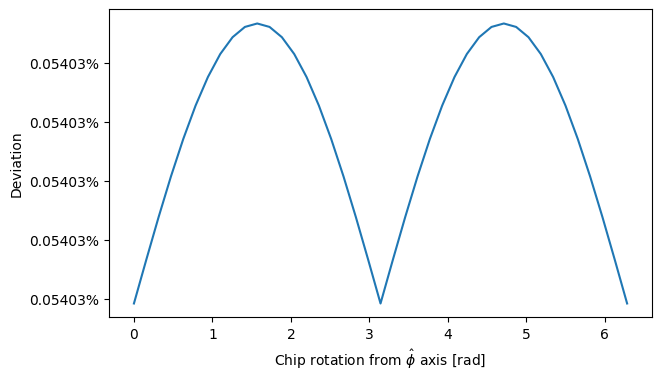

In [102]:
fig = plt.figure(1, (7,4))
ax = fig.add_subplot(1,1,1)
ax.plot(np.linspace(0, np.pi*2, angle_resolution), deviation)
ax.set_xlabel("Chip rotation from $\hat{\phi}$ axis [rad]")
ax.set_ylabel("Deviation")
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.show()

### z axis

In [103]:
# 7cm from the magnet with different angles
cube = magpy.magnet.Cuboid(polarization=(500, 0, 0), dimension=magnet_size)

x = np.linspace(-chip_size / 2, chip_size / 2, resolution)
y = np.linspace(-chip_size / 2, chip_size / 2, resolution)
chip_points = np.array([
    [(xi, yi, 0) for yi in y]
    for xi in x
])

sensor = magpy.Sensor(pixel=chip_points)
sensor.position = (0, 0, chip_dist+0.05)
sensor.rotate_from_rotvec([(0, 0, theta) for theta in np.linspace(0, 360, angle_resolution)])

B = magpy.getB(cube, sensor)
print(B.shape)

(42, 20, 20, 3)


In [104]:
B_flat = B[1::].reshape((angle_resolution, resolution**2, 3))
diff = np.array([[[vec1 - vec2 for vec1 in B_flat_zi] for vec2 in B_flat_zi] for B_flat_zi in B_flat])
amp_diff = np.linalg.norm(diff, axis=3)
max_diff = np.max(amp_diff,axis=(1,2))
mean_B = np.mean(np.linalg.norm(B[1::],axis=3),axis=(1,2))
deviation = max_diff / mean_B
print(f"Max Difference: {max_diff}")
print(f"Mean B: {mean_B}")
print(f"Deviation: {deviation}")

Max Difference: [0.00728601 0.00833609 0.00918091 0.00979966 0.01017711 0.01030397
 0.01017711 0.00979966 0.00918091 0.00833609 0.00728601 0.00833609
 0.00918091 0.00979966 0.01017711 0.01030397 0.01017711 0.00979966
 0.00918091 0.00833609 0.00728601 0.00833609 0.00918091 0.00979966
 0.01017711 0.01030397 0.01017711 0.00979966 0.00918091 0.00833609
 0.00728601 0.00833609 0.00918091 0.00979966 0.01017711 0.01030397
 0.01017711 0.00979966 0.00918091 0.00833609 0.00728601]
Mean B: [13.48481953 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953
 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953
 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953
 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953
 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953
 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953
 13.48481953 13.48481953 13.48481953 13.48481953 13.48481953]
Deviation: [0.000

<>:4: SyntaxWarning:

invalid escape sequence '\h'

<>:4: SyntaxWarning:

invalid escape sequence '\h'

/tmp/ipython-input-1125877609.py:4: SyntaxWarning:

invalid escape sequence '\h'



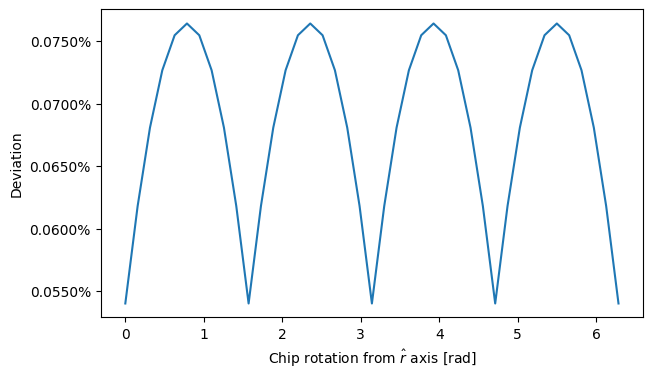

In [105]:
fig = plt.figure(1, (7,4))
ax = fig.add_subplot(1,1,1)
ax.plot(np.linspace(0, np.pi*2, angle_resolution), deviation)
ax.set_xlabel("Chip rotation from $\hat{r}$ axis [rad]")
ax.set_ylabel("Deviation")
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.show()

## Fluctuation
### x direction

In [118]:
# 7cm from the magnet
cube = magpy.magnet.Cuboid(polarization=(500, 0, 0), dimension=magnet_size)
x_deviations = []
for chip_size in np.linspace(fluc_min, fluc_max, fluc_resolution):
  x = np.linspace(-chip_size / 2, chip_size / 2, resolution)
  y = np.linspace(-chip_size / 2, chip_size / 2, resolution)
  chip_points = np.array([
      [(xi, 0, 0) for yi in y]
      for xi in x
  ])
  sensor = magpy.Sensor(pixel=chip_points)
  sensor.position = (0, 0, chip_dist+0.05)

  B = magpy.getB(cube, sensor)
  B_flat = B.reshape((resolution**2, 3))
  diff = np.array([[vec1 - vec2 for vec1 in B_flat] for vec2 in B_flat])
  amp_diff = np.linalg.norm(diff, axis=2)
  max_diff = np.max(amp_diff,axis=(0,1))
  mean_B = np.mean(np.linalg.norm(B,axis=2),axis=(0,1))
  deviation = max_diff / mean_B
  x_deviations.append(deviation)


In [119]:
cube = magpy.magnet.Cuboid(polarization=(500, 0, 0), dimension=magnet_size)
y_deviations = []
for chip_size in np.linspace(fluc_min, fluc_max, fluc_resolution):
  x = np.linspace(-chip_size / 2, chip_size / 2, resolution)
  y = np.linspace(-chip_size / 2, chip_size / 2, resolution)
  chip_points = np.array([
      [(0, yi, 0) for yi in y]
      for xi in x
  ])
  sensor = magpy.Sensor(pixel=chip_points)
  sensor.position = (0, 0, chip_dist+0.05)

  B = magpy.getB(cube, sensor)
  B_flat = B.reshape((resolution**2, 3))
  diff = np.array([[vec1 - vec2 for vec1 in B_flat] for vec2 in B_flat])
  amp_diff = np.linalg.norm(diff, axis=2)
  max_diff = np.max(amp_diff,axis=(0,1))
  mean_B = np.mean(np.linalg.norm(B,axis=2),axis=(0,1))
  deviation = max_diff / mean_B
  y_deviations.append(deviation)

### z direction

In [120]:
# 7cm from the magnet
cube = magpy.magnet.Cuboid(polarization=(500, 0, 0), dimension=magnet_size)
z_deviations = []
for chip_size in np.linspace(fluc_min, fluc_max, fluc_resolution):
  y = np.linspace(-chip_size / 2, chip_size / 2, resolution)
  z = np.linspace(-chip_size / 2, chip_size / 2, resolution)
  chip_points = np.array([
      [(0, 0, zi) for zi in z]
      for yi in y
  ])
  sensor = magpy.Sensor(pixel=chip_points)
  sensor.position = (0, 0, chip_dist+0.05)

  B = magpy.getB(cube, sensor)
  B_flat = B.reshape((resolution**2, 3))
  diff = np.array([[vec1 - vec2 for vec1 in B_flat] for vec2 in B_flat])
  amp_diff = np.linalg.norm(diff, axis=2)
  max_diff = np.max(amp_diff,axis=(0,1))
  mean_B = np.mean(np.linalg.norm(B,axis=2),axis=(0,1))
  deviation = max_diff / mean_B
  z_deviations.append(deviation)


<>:3: SyntaxWarning:

invalid escape sequence '\h'

<>:4: SyntaxWarning:

invalid escape sequence '\h'

<>:5: SyntaxWarning:

invalid escape sequence '\h'

<>:6: SyntaxWarning:

invalid escape sequence '\s'

<>:7: SyntaxWarning:

invalid escape sequence '\s'

<>:3: SyntaxWarning:

invalid escape sequence '\h'

<>:4: SyntaxWarning:

invalid escape sequence '\h'

<>:5: SyntaxWarning:

invalid escape sequence '\h'

<>:6: SyntaxWarning:

invalid escape sequence '\s'

<>:7: SyntaxWarning:

invalid escape sequence '\s'

/tmp/ipython-input-2648817444.py:3: SyntaxWarning:

invalid escape sequence '\h'

/tmp/ipython-input-2648817444.py:4: SyntaxWarning:

invalid escape sequence '\h'

/tmp/ipython-input-2648817444.py:5: SyntaxWarning:

invalid escape sequence '\h'

/tmp/ipython-input-2648817444.py:6: SyntaxWarning:

invalid escape sequence '\s'

/tmp/ipython-input-2648817444.py:7: SyntaxWarning:

invalid escape sequence '\s'



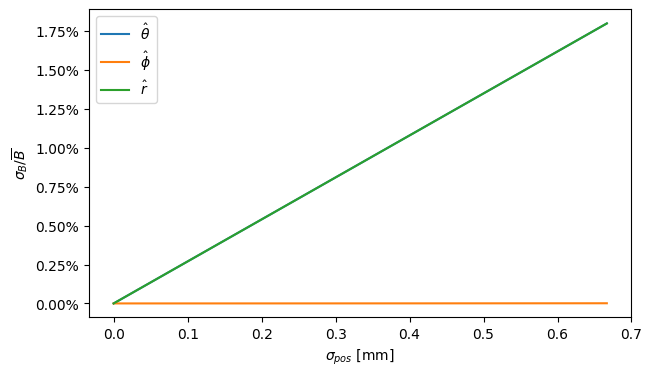

In [121]:
fig = plt.figure(1, (7,4))
ax = fig.add_subplot(1,1,1)
ax.plot(np.linspace(fluc_min*1000, fluc_max*1000, fluc_resolution), x_deviations, label='$\hat{\\theta}$')
ax.plot(np.linspace(fluc_min*1000, fluc_max*1000, fluc_resolution), y_deviations, label='$\hat{\phi}$')
ax.plot(np.linspace(fluc_min*1000, fluc_max*1000, fluc_resolution), z_deviations, label='$\hat{r}$')
ax.set_xlabel("$\sigma_{pos}$ [mm]")
ax.set_ylabel("$\sigma_{B}/\overline{B}$")
ax.legend()
ax.yaxis.set_major_formatter(mtick.PercentFormatter(1.0))
plt.show()

In [122]:
x_slope = np.polyfit(np.linspace(fluc_min*1000, fluc_max*1000, fluc_resolution), x_deviations, 1)
print(x_slope)
y_slope = np.polyfit(np.linspace(fluc_min*1000, fluc_max*1000, fluc_resolution), y_deviations, 1)
print(y_slope)
z_slope = np.polyfit(np.linspace(fluc_min*1000, fluc_max*1000, fluc_resolution), z_deviations, 1)
print(z_slope)

[2.70150265e-02 8.28042270e-08]
[ 1.57583867e-05 -1.72174855e-06]
[ 2.70158245e-02 -3.37822604e-08]


<>:5: SyntaxWarning:

invalid escape sequence '\s'

<>:5: SyntaxWarning:

invalid escape sequence '\s'

/tmp/ipython-input-1254999952.py:5: SyntaxWarning:

invalid escape sequence '\s'

/tmp/ipython-input-1254999952.py:4: RuntimeWarning:

divide by zero encountered in divide



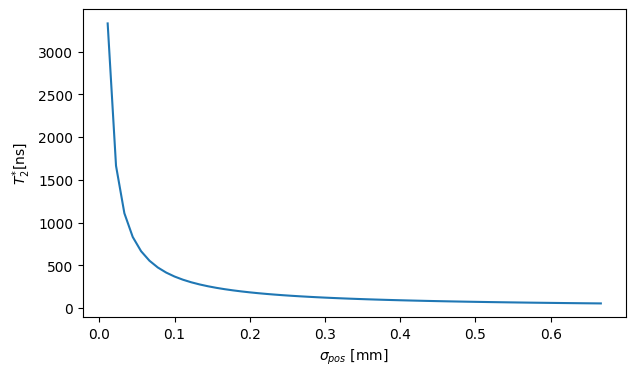

In [123]:
fig = plt.figure(1, (7,4))
ax = fig.add_subplot(1,1,1)
x = np.linspace(0*1000, fluc_max*1000, fluc_resolution)
ax.plot(x, 1/np.array(x_deviations))
ax.set_xlabel("$\sigma_{pos}$ [mm]")
ax.set_ylabel("$T_{2}^{*}$[ns]")
plt.show()

## Simulation measurement comparison

In [112]:
#polarization adjusted to approximated fit the measured strength at 7cm
cube = magpy.magnet.Cuboid(polarization=(1000, 0, 0), dimension=magnet_size)
steps = np.array([(0, 0, zi+0.05) for zi in np.linspace(0, 0.5, 50)])

x = np.linspace(-chip_size / 2, chip_size / 2, resolution)
y = np.linspace(-chip_size / 2, chip_size / 2, resolution)
chip_points = np.array([
    [(xi, yi, 0) for yi in y]
    for xi in x
])

sensor = magpy.Sensor(pixel=chip_points)
sensor.position = steps

B = magpy.getB(cube, sensor)
print(B.shape)

(50, 20, 20, 3)


In [113]:
B_flat = B.reshape((50, resolution**2, 3))
mean_B = np.mean(np.linalg.norm(B,axis=3),axis=(1,2))
print(f"Mean B: {mean_B}")
x = np.linspace(0, 0.5, 50)
theory_B = 26*(0.07)**3/x**3

measured_B = [np.float64(277.6300000000001), np.float64(192.8235340909091), np.float64(127.01991569390404), np.float64(86.80738309352519), np.float64(61.52788623141564), np.float64(45.03114526823388), np.float64(33.90382472431805), np.float64(26.109647550776586), np.float64(20.553389662027833), np.float64(16.42916414294367), np.float64(13.329001085776328), np.float64(10.93547288776797), np.float64(9.064261968085106), np.float64(7.612570117287098), np.float64(6.4126501766784445), np.float64(5.454171097148381), np.float64(4.663363943934268), np.float64(4.0387344199424735), np.float64(3.496256062075655), np.float64(3.043253379851723), np.float64(2.65481352560915), np.float64(2.3363908701854497), np.float64(2.0816060291060294), np.float64(1.8392617107942972), np.float64(1.608147768086198), np.float64(1.4223122238586157), np.float64(1.2670812038614423), np.float64(1.13008073196986), np.float64(1.011274347969627), np.float64(0.9075601604278075), np.float64(0.815655577299413), np.float64(0.7305065666041275), np.float64(0.6582420894023103), np.float64(0.5909761904761905), np.float64(0.5316405484818806), np.float64(0.47995073891625617), np.float64(0.4344010695187166), np.float64(0.39299109481403877), np.float64(0.35816789862724396), np.float64(0.3188539741219963), np.float64(0.2891404494382022), np.float64(0.2619004282655246), np.float64(0.23560220994475137), np.float64(0.2110159055926116), np.float64(0.19277688603531304), np.float64(0.17595584545910684), np.float64(0.15599512195121953), np.float64(0.14014712245781047), np.float64(0.127588504789671), np.float64(0.10933491686460808)]

Mean B: [6.65587079e+02 2.27600342e+02 1.48271039e+02 9.78344948e+01
 6.67575071e+01 4.72215557e+01 3.45149109e+01 2.59547561e+01
 1.99986171e+01 1.57338907e+01 1.26026091e+01 1.02524838e+01
 8.45434961e+00 7.05503218e+00 5.94961381e+00 5.06463086e+00
 4.34761467e+00 3.76041588e+00 3.27484469e+00 2.86976309e+00
 2.52910793e+00 2.24052284e+00 1.99439607e+00 1.78317373e+00
 1.60086273e+00 1.44266649e+00 1.30471476e+00 1.18386110e+00
 1.07752945e+00 9.83596831e-01 9.00302888e-01 8.26179486e-01
 7.59995560e-01 7.00713546e-01 6.47454747e-01 5.99471620e-01
 5.56125448e-01 5.16868276e-01 4.81228183e-01 4.48797238e-01
 4.19221585e-01 3.92193249e-01 3.67443333e-01 3.44736348e-01
 3.23865460e-01 3.04648498e-01 2.86924586e-01 2.70551293e-01
 2.55402206e-01 2.41364866e-01]


/tmp/ipython-input-3591812620.py:5: RuntimeWarning:

divide by zero encountered in divide



<>:7: SyntaxWarning:

invalid escape sequence '\m'

<>:7: SyntaxWarning:

invalid escape sequence '\m'

/tmp/ipython-input-3825826817.py:7: SyntaxWarning:

invalid escape sequence '\m'



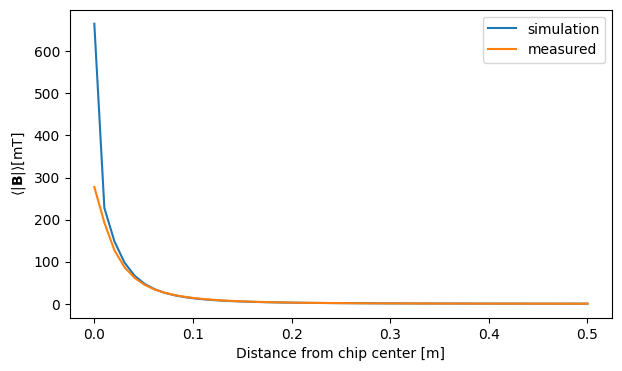

In [114]:
fig = plt.figure(1, (7,4))
ax = fig.add_subplot(1,1,1)
# ax.plot(np.linspace(0, 0.5, 50), theory_B, label='theory')
ax.plot(np.linspace(0, 0.5, 50), mean_B, label='simulation')
ax.plot(np.linspace(0, 0.5, 50), measured_B, label='measured')
ax.set_xlabel("Distance from chip center [m]")
ax.set_ylabel("$\\langle|\mathbf{B}|\\rangle$[mT]")
ax.legend()
plt.show()